# Cancelation Prediction With CatBoost

## Imports

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import joblib
import shap

from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import classification_report, ConfusionMatrixDisplay, RocCurveDisplay, roc_auc_score, f1_score
from sklearn.base import BaseEstimator, TransformerMixin
from category_encoders import TargetEncoder
from catboost import CatBoostClassifier
from sklearn.model_selection import train_test_split, RandomizedSearchCV

import sys
import os
sys.path.append(os.path.abspath(".."))
from common_functions import optimal_f1_search

c:\Users\Sebastijan\anaconda3\envs\hotel_management\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## Dataset Import

In [2]:
data = pd.read_parquet("../../data/hotel_booking_optimized.parquet")
data.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,name,email,phone-number,credit_card
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,...,Transient,0.0,0,0,Check-Out,2015-07-01,Ernest Barnes,Ernest.Barnes31@outlook.com,669-792-1661,************4322
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,...,Transient,0.0,0,0,Check-Out,2015-07-01,Andrea Baker,Andrea_Baker94@aol.com,858-637-6955,************9157
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,...,Transient,75.0,0,0,Check-Out,2015-07-02,Rebecca Parker,Rebecca_Parker@comcast.net,652-885-2745,************3734
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,...,Transient,75.0,0,0,Check-Out,2015-07-02,Laura Murray,Laura_M@gmail.com,364-656-8427,************5677
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,...,Transient,98.0,0,1,Check-Out,2015-07-03,Linda Hines,LHines@verizon.com,713-226-5883,************5498


## Pipeline

Will use the same approach to column selection and feature engineering as we did with XGBoost.

In [3]:
# A function to map week number to season
def week_to_season(week):
    if 10 <= week <= 21:
        return 'Spring'
    elif 22 <= week <= 34:
        return 'Summer'
    elif 35 <= week <= 47:
        return 'Fall'
    else:
        return 'Winter'

data["total_stay"] = data["stays_in_weekend_nights"] + data["stays_in_week_nights"]
data["adr_per_person"] = data["adr"] / (data["adults"] + data["children"] + data["babies"])
data["arrival_season"] = data["arrival_date_week_number"].apply(week_to_season)

In [4]:
# Columns for one-hot encoding (low-cardinality categorical)
onehot_cols = [
    "hotel", "meal", "market_segment", "distribution_channel",
    "customer_type", "deposit_type", "arrival_date_month", "arrival_season"
]

# Columns for target encoding (high-cardinality categorical)
target_cols = ["agent", "country"]

# Numeric / passthrough columns
numeric_cols = [
    "lead_time", "arrival_date_year", "arrival_date_week_number",
    "arrival_date_day_of_month", "stays_in_weekend_nights", "stays_in_week_nights",
    "adults", "children", "babies", "previous_cancellations",
    "previous_bookings_not_canceled", "days_in_waiting_list",
    "adr", "required_car_parking_spaces", "total_of_special_requests",
    "is_repeated_guest", "total_stay", "adr_per_person"
]

# Unincluded columns will be dropped in the preprocessing step

In [5]:
# Target encoding for high-cardinality categorical features
target_encoder = TargetEncoder(cols=target_cols, smoothing=5)  # CV-safe inside pipeline

# ColumnTransformer
preprocessor = ColumnTransformer(
    transformers=[
        ("target", target_encoder, target_cols),
        ("onehot", OneHotEncoder(handle_unknown="ignore"), onehot_cols),
        ("numeric", "passthrough", numeric_cols)
    ]
)

In [6]:
pipeline = Pipeline([
    # preprocessing step
    ("preprocessing", preprocessor),

    # model step
    ("model", CatBoostClassifier(
        # Basic hyperparameters
        iterations=2500,      # number of boosting rounds - increase for better performance
        task_type='GPU',      # enable GPU
        devices='0',          # GPU device
        verbose=1,           # print progress every iteration
        early_stopping_rounds=100,  # stop if no improvement for 100 rounds
        random_state=42
    ))
])

## Train/Test Split

In [7]:
X = data.drop("is_canceled", axis=1)
y = data["is_canceled"]

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

## First Model

### Parameters to search for

In [8]:
param_distributions = {
    'model__depth': [4, 6, 8, 10],
    'model__learning_rate': [0.01, 0.03, 0.05, 0.1],
    'model__l2_leaf_reg': [1, 3, 5, 7, 9],
    'model__bagging_temperature': [0, 1, 2, 5],
    'model__border_count': [32, 64, 128, 254],
    'model__min_data_in_leaf': [1, 5, 10, 20],
    'model__colsample_bylevel': [0.6, 0.8, 1.0]
}

### Randomized search setup

In [9]:
random_search = RandomizedSearchCV(
    pipeline,
    param_distributions=param_distributions,
    n_iter=50, # Number of random combinations to try
    cv=3,
    scoring="roc_auc",
    verbose=3,
    n_jobs=1, # Use 1 to avoid potential GPU conflicts
    random_state=42
)

### Search

In [10]:
random_search.fit(X_train, y_train)

cat_boost_pipeline_1 = random_search.best_estimator_
cat_boost_pipeline_1

Fitting 3 folds for each of 50 candidates, totalling 150 fits
[CV 1/3] END model__bagging_temperature=1, model__border_count=254, model__colsample_bylevel=0.8, model__depth=8, model__l2_leaf_reg=9, model__learning_rate=0.03, model__min_data_in_leaf=10;, score=nan total time=   0.6s
[CV 2/3] END model__bagging_temperature=1, model__border_count=254, model__colsample_bylevel=0.8, model__depth=8, model__l2_leaf_reg=9, model__learning_rate=0.03, model__min_data_in_leaf=10;, score=nan total time=   0.5s
[CV 3/3] END model__bagging_temperature=1, model__border_count=254, model__colsample_bylevel=0.8, model__depth=8, model__l2_leaf_reg=9, model__learning_rate=0.03, model__min_data_in_leaf=10;, score=nan total time=   0.5s
0:	learn: 0.5913524	total: 8.72s	remaining: 6h 3m 9s
1:	learn: 0.5227868	total: 8.73s	remaining: 3h 1m 39s
2:	learn: 0.4750557	total: 8.73s	remaining: 2h 1m 9s
3:	learn: 0.4391663	total: 8.74s	remaining: 1h 30m 53s
4:	learn: 0.4166079	total: 8.74s	remaining: 1h 12m 44s
5:	le

c:\Users\Sebastijan\anaconda3\envs\hotel_management\Lib\site-packages\sklearn\model_selection\_validation.py:516: FitFailedWarning: 
99 fits failed out of a total of 150.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
99 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Sebastijan\anaconda3\envs\hotel_management\Lib\site-packages\sklearn\model_selection\_validation.py", line 859, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Sebastijan\anaconda3\envs\hotel_management\Lib\site-packages\sklearn\base.py", line 1365, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\Sebastijan\anaconda3

0:	learn: 0.6560143	total: 13.8ms	remaining: 34.4s
1:	learn: 0.6227519	total: 26.9ms	remaining: 33.6s
2:	learn: 0.5948785	total: 39.6ms	remaining: 32.9s
3:	learn: 0.5681563	total: 52.5ms	remaining: 32.8s
4:	learn: 0.5458657	total: 67.9ms	remaining: 33.9s
5:	learn: 0.5253838	total: 80.1ms	remaining: 33.3s
6:	learn: 0.5068559	total: 92.7ms	remaining: 33s
7:	learn: 0.4907500	total: 105ms	remaining: 32.7s
8:	learn: 0.4761574	total: 117ms	remaining: 32.5s
9:	learn: 0.4625631	total: 130ms	remaining: 32.4s
10:	learn: 0.4509978	total: 142ms	remaining: 32.2s
11:	learn: 0.4411255	total: 155ms	remaining: 32.1s
12:	learn: 0.4318253	total: 168ms	remaining: 32.1s
13:	learn: 0.4239559	total: 180ms	remaining: 32s
14:	learn: 0.4164259	total: 193ms	remaining: 31.9s
15:	learn: 0.4098519	total: 205ms	remaining: 31.9s
16:	learn: 0.4037385	total: 218ms	remaining: 31.9s
17:	learn: 0.3981608	total: 232ms	remaining: 32s
18:	learn: 0.3928830	total: 245ms	remaining: 32.1s
19:	learn: 0.3880955	total: 259ms	remain

,steps,"[('preprocessing', ...), ('model', ...)]"
,transform_input,None
,memory,None
,verbose,False
,transformers,"[('target', ...), ('onehot', ...), ...]"
,remainder,'drop'
,sparse_threshold,0.3
,n_jobs,None
,transformer_weights,None
,verbose,False
,verbose_feature_names_out,True


### Evaluation

In [11]:
random_search.best_params_

{'model__min_data_in_leaf': 10,
 'model__learning_rate': 0.03,
 'model__l2_leaf_reg': 7,
 'model__depth': 10,
 'model__colsample_bylevel': 1.0,
 'model__border_count': 64,
 'model__bagging_temperature': 1}

In [12]:
y_pred_train = cat_boost_pipeline_1.predict(X_train)
y_pred_test = cat_boost_pipeline_1.predict(X_test)

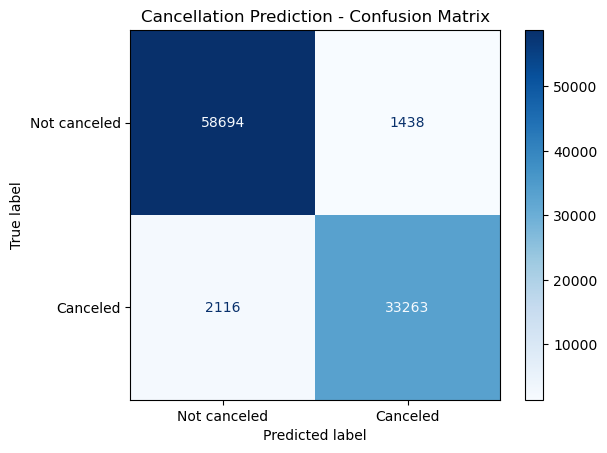

              precision    recall  f1-score   support

Not canceled       0.97      0.98      0.97     60132
    Canceled       0.96      0.94      0.95     35379

    accuracy                           0.96     95511
   macro avg       0.96      0.96      0.96     95511
weighted avg       0.96      0.96      0.96     95511



In [13]:
disp = ConfusionMatrixDisplay.from_predictions(
    y_train, y_pred_train,
    display_labels=["Not canceled", "Canceled"],
    cmap="Blues",
    normalize=None
)
disp.ax_.set_title("Cancellation Prediction - Confusion Matrix")
plt.show();

print(classification_report(y_train, y_pred_train, target_names=["Not canceled", "Canceled"]))

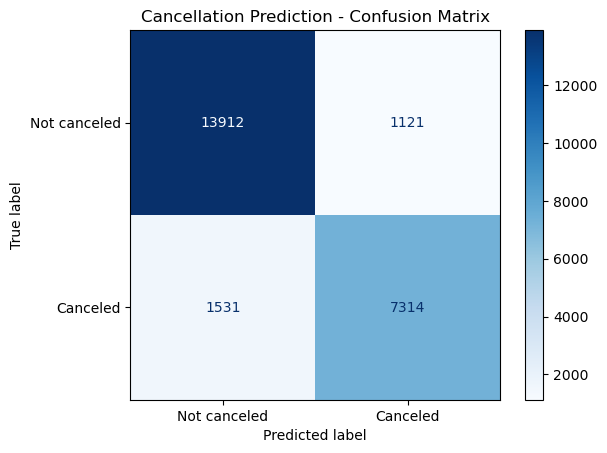

              precision    recall  f1-score   support

Not canceled       0.90      0.93      0.91     15033
    Canceled       0.87      0.83      0.85      8845

    accuracy                           0.89     23878
   macro avg       0.88      0.88      0.88     23878
weighted avg       0.89      0.89      0.89     23878



In [14]:
disp = ConfusionMatrixDisplay.from_predictions(
    y_test, y_pred_test,
    display_labels=["Not canceled", "Canceled"],
    cmap="Blues",
    normalize=None
)
disp.ax_.set_title("Cancellation Prediction - Confusion Matrix")
plt.show();

print(classification_report(y_test, y_pred_test, target_names=["Not canceled", "Canceled"]))

ROC-AUC: 0.9575317982368317


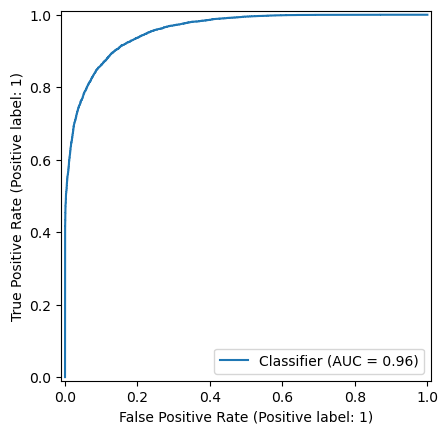

In [15]:
y_probs = cat_boost_pipeline_1.predict_proba(X_test)[:,1]
auc = roc_auc_score(y_test, y_probs)
print("ROC-AUC:", auc)

RocCurveDisplay.from_predictions(y_test, y_probs)
plt.show();

Best threshold: 0.46
Best F1: 0.8497050816696915


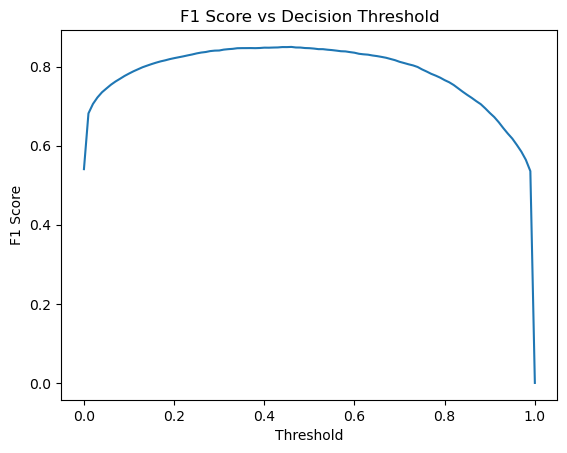

In [16]:
optimal_f1_search(y_test, y_probs)

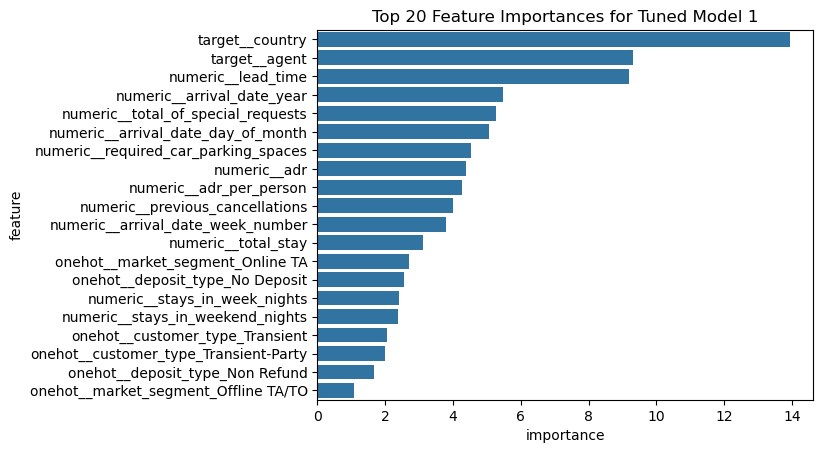

In [17]:
feature_names = cat_boost_pipeline_1.named_steps["preprocessing"].get_feature_names_out()
tuned_cat_boost_model = cat_boost_pipeline_1.named_steps['model']
importances = tuned_cat_boost_model.feature_importances_

df_imp = pd.DataFrame({
    'feature': feature_names,
    'importance': importances
}).sort_values(by='importance', ascending=False).head(20)

sns.barplot(x='importance', y='feature', data=df_imp)
plt.title("Top 20 Feature Importances for Tuned Model 1")
plt.show();

## Second Model

### Parameters to search for

In [23]:
param_distributions_2 = {
    'model__depth': [9, 10], # higher could lead to overfitting
    'model__learning_rate': [0.02, 0.03, 0.04],
    'model__l2_leaf_reg': [6, 7, 8],
    'model__bagging_temperature': [1], # will keep constant based on previous results
    'model__border_count': [64], # usually 32 or 128 work well with gpu, but previously 64 gave best results
    'model__min_data_in_leaf': [9, 10, 11],
    'model__colsample_bylevel': [1.0], # will stick to 1.0 based on previous results
}

### Randomized search setup

In [24]:
random_search_2 = RandomizedSearchCV(
    pipeline,
    param_distributions=param_distributions_2,
    n_iter=50,
    cv=3,
    scoring="roc_auc",
    verbose=3,
    n_jobs=1,
    random_state=42
)

### Search

In [25]:
random_search_2.fit(X_train, y_train)

cat_boost_pipeline_2 = random_search_2.best_estimator_
cat_boost_pipeline_2

Fitting 3 folds for each of 50 candidates, totalling 150 fits
0:	learn: 0.6696821	total: 9.8ms	remaining: 24.5s
1:	learn: 0.6478712	total: 18.6ms	remaining: 23.2s
2:	learn: 0.6276392	total: 27.7ms	remaining: 23.1s
3:	learn: 0.6089697	total: 37.1ms	remaining: 23.2s
4:	learn: 0.5914535	total: 46.5ms	remaining: 23.2s
5:	learn: 0.5749040	total: 55.1ms	remaining: 22.9s
6:	learn: 0.5597428	total: 64.6ms	remaining: 23s
7:	learn: 0.5459348	total: 73.5ms	remaining: 22.9s
8:	learn: 0.5331178	total: 82.7ms	remaining: 22.9s
9:	learn: 0.5221457	total: 91.8ms	remaining: 22.9s
10:	learn: 0.5106952	total: 101ms	remaining: 22.9s
11:	learn: 0.4999160	total: 110ms	remaining: 22.9s
12:	learn: 0.4905115	total: 119ms	remaining: 22.7s
13:	learn: 0.4814953	total: 127ms	remaining: 22.6s
14:	learn: 0.4732926	total: 136ms	remaining: 22.5s
15:	learn: 0.4652377	total: 144ms	remaining: 22.4s
16:	learn: 0.4583570	total: 153ms	remaining: 22.3s
17:	learn: 0.4519365	total: 162ms	remaining: 22.3s
18:	learn: 0.4455489	to

,steps,"[('preprocessing', ...), ('model', ...)]"
,transform_input,None
,memory,None
,verbose,False
,transformers,"[('target', ...), ('onehot', ...), ...]"
,remainder,'drop'
,sparse_threshold,0.3
,n_jobs,None
,transformer_weights,None
,verbose,False
,verbose_feature_names_out,True


### Evaluation

In [26]:
random_search_2.best_params_

{'model__min_data_in_leaf': 10,
 'model__learning_rate': 0.03,
 'model__l2_leaf_reg': 7,
 'model__depth': 10,
 'model__colsample_bylevel': 1.0,
 'model__border_count': 64,
 'model__bagging_temperature': 1}

In [27]:
y_pred_train_2 = cat_boost_pipeline_2.predict(X_train)
y_pred_test_2 = cat_boost_pipeline_2.predict(X_test)

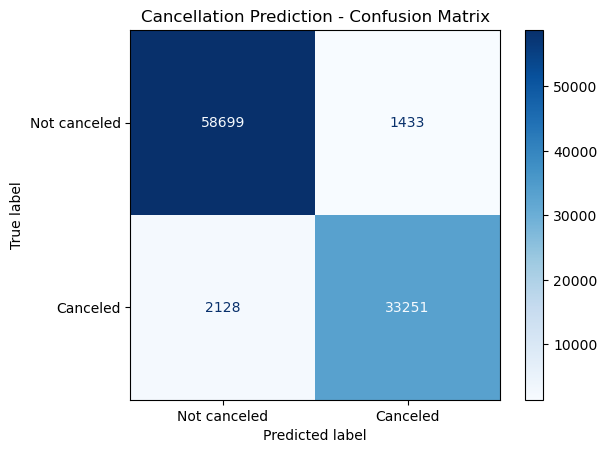

              precision    recall  f1-score   support

Not canceled       0.97      0.98      0.97     60132
    Canceled       0.96      0.94      0.95     35379

    accuracy                           0.96     95511
   macro avg       0.96      0.96      0.96     95511
weighted avg       0.96      0.96      0.96     95511



In [28]:
disp = ConfusionMatrixDisplay.from_predictions(
    y_train, y_pred_train_2,
    display_labels=["Not canceled", "Canceled"],
    cmap="Blues",
    normalize=None
)
disp.ax_.set_title("Cancellation Prediction - Confusion Matrix")
plt.show();

print(classification_report(y_train, y_pred_train_2, target_names=["Not canceled", "Canceled"]))

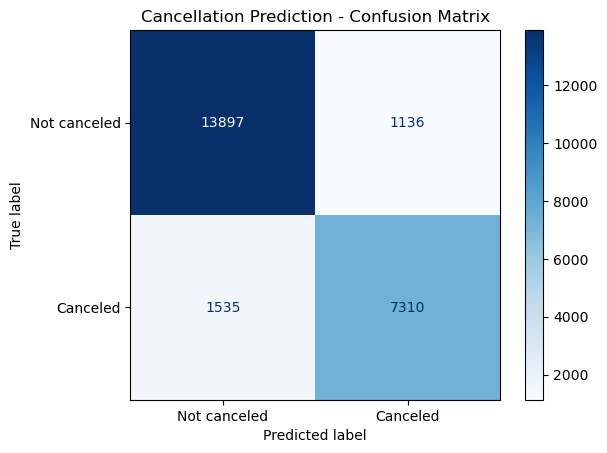

              precision    recall  f1-score   support

Not canceled       0.90      0.92      0.91     15033
    Canceled       0.87      0.83      0.85      8845

    accuracy                           0.89     23878
   macro avg       0.88      0.88      0.88     23878
weighted avg       0.89      0.89      0.89     23878



In [29]:
disp = ConfusionMatrixDisplay.from_predictions(
    y_test, y_pred_test_2,
    display_labels=["Not canceled", "Canceled"],
    cmap="Blues",
    normalize=None
)
disp.ax_.set_title("Cancellation Prediction - Confusion Matrix")
plt.show();

print(classification_report(y_test, y_pred_test_2, target_names=["Not canceled", "Canceled"]))

ROC-AUC: 0.9575970550863095


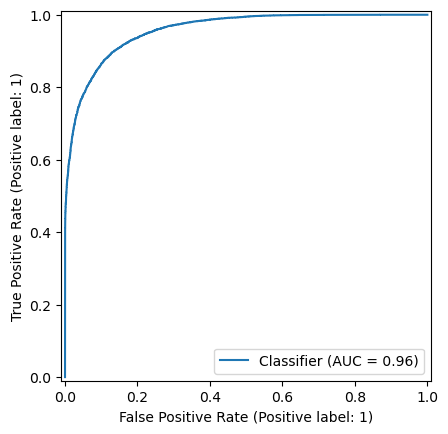

In [30]:
y_probs_2 = cat_boost_pipeline_2.predict_proba(X_test)[:,1]
auc = roc_auc_score(y_test, y_probs_2)
print("ROC-AUC:", auc)

RocCurveDisplay.from_predictions(y_test, y_probs_2)
plt.show();

Best threshold: 0.4
Best F1: 0.8498071625344352


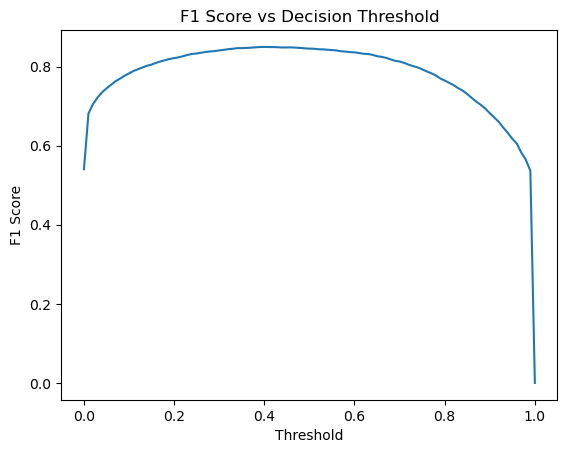

In [31]:
optimal_f1_search(y_test, y_probs_2)

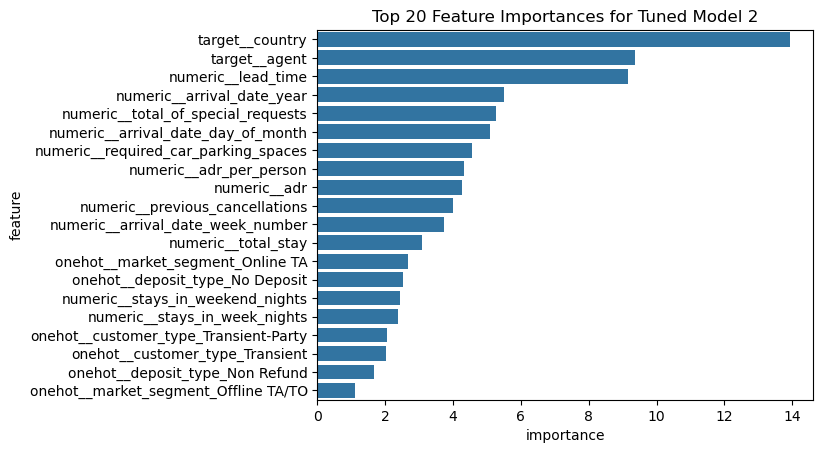

In [32]:
feature_names_2 = cat_boost_pipeline_2.named_steps["preprocessing"].get_feature_names_out()
tuned_cat_boost_model_2 = cat_boost_pipeline_2.named_steps['model']
importances_2 = tuned_cat_boost_model_2.feature_importances_

df_imp_2 = pd.DataFrame({
    'feature': feature_names_2,
    'importance': importances_2
}).sort_values(by='importance', ascending=False).head(20)

sns.barplot(x='importance', y='feature', data=df_imp_2)
plt.title("Top 20 Feature Importances for Tuned Model 2")
plt.show();

## Final reassurrance that we don't need one model per hotel

In [33]:
pd.crosstab(X_test['hotel'], y_test, normalize='index')

is_canceled,0,1
hotel,,
City Hotel,0.575865,0.424135
Resort Hotel,0.733555,0.266445


The differences of cancellation rates between the two hotels are small enough to make the creation of separate model not needed.

## Saving the best model, f1 threshold, feature importances, and mean shap values

### Save model

In [42]:
# Custom transformer for engineered features
class FeatureEngineer(BaseEstimator, TransformerMixin):
    def __init__(self):
        pass
    
    def fit(self, X, y=None):
        return self
    
    # A function to map week number to season
    def week_to_season(self, week):
        if 10 <= week <= 21:
            return 'Spring'
        elif 22 <= week <= 34:
            return 'Summer'
        elif 35 <= week <= 47:
            return 'Fall'
        else:
            return 'Winter'

    def transform(self, X):
        X = X.copy()
        # total_stay
        X['total_stay'] = X['stays_in_weekend_nights'] + X['stays_in_week_nights']
        # adr_per_person
        X['adr_per_person'] = X['adr'] / (X['adults'] + X['children'] + X['babies']).replace(0, 1)
        # arrival_season
        X['arrival_season'] = X['arrival_date_week_number'].apply(self.week_to_season)
        return X

In [43]:
pipeline_final = Pipeline([
    ("feature_engineering", FeatureEngineer()),
    ("preprocessing", preprocessor),
    ("model", CatBoostClassifier(
        iterations=2500,
        task_type='CPU', # using CPU for production environment
        # devices='0', # not needed for CPU
        verbose=1,
        early_stopping_rounds=100,
        random_state=42,
        **{key.replace('model__', ''): value for key, value in random_search_2.best_params_.items() if key.startswith('model__')}
    ))
])

In [44]:
pipeline_final.fit(X_train, y_train)

0:	learn: 0.6563853	total: 21.5ms	remaining: 53.7s
1:	learn: 0.6228308	total: 41.8ms	remaining: 52.2s
2:	learn: 0.5950228	total: 63.1ms	remaining: 52.5s
3:	learn: 0.5686261	total: 84.5ms	remaining: 52.7s
4:	learn: 0.5469262	total: 105ms	remaining: 52.5s
5:	learn: 0.5261698	total: 130ms	remaining: 54.1s
6:	learn: 0.5082451	total: 154ms	remaining: 54.7s
7:	learn: 0.4927726	total: 175ms	remaining: 54.7s
8:	learn: 0.4790989	total: 202ms	remaining: 56s
9:	learn: 0.4653335	total: 240ms	remaining: 59.6s
10:	learn: 0.4533523	total: 279ms	remaining: 1m 3s
11:	learn: 0.4425920	total: 315ms	remaining: 1m 5s
12:	learn: 0.4332027	total: 348ms	remaining: 1m 6s
13:	learn: 0.4246301	total: 385ms	remaining: 1m 8s
14:	learn: 0.4175644	total: 421ms	remaining: 1m 9s
15:	learn: 0.4109990	total: 455ms	remaining: 1m 10s
16:	learn: 0.4055933	total: 496ms	remaining: 1m 12s
17:	learn: 0.3996958	total: 551ms	remaining: 1m 16s
18:	learn: 0.3943481	total: 596ms	remaining: 1m 17s
19:	learn: 0.3895459	total: 632ms	r

,steps,"[('feature_engineering', ...), ('preprocessing', ...), ...]"
,transform_input,None
,memory,None
,verbose,False
,transformers,"[('target', ...), ('onehot', ...), ...]"
,remainder,'drop'
,sparse_threshold,0.3
,n_jobs,None
,transformer_weights,None
,verbose,False
,verbose_feature_names_out,True


In [45]:
joblib.dump(pipeline_final, "../../models/catboost_cancellation_model_final.joblib")

['../../models/catboost_cancellation_model_final.joblib']

### Save feature importances

In [46]:
df_imp_2.to_csv("../../models/catboost_cancellation_model_final_feature_importances.csv", index=False)

### Save shap values

In [48]:
X_sample = X_test.copy()
X_sample.head()

,hotel,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,...,total_of_special_requests,reservation_status,reservation_status_date,name,email,phone-number,credit_card,total_stay,adr_per_person,arrival_season
93581,City Hotel,83,2016,July,30,23,0,1,2,0,...,1,Check-Out,2016-07-24,Karina Hart,Karina.Hart21@verizon.com,423-362-0485,************9464,1,52.650002,Summer
118099,City Hotel,146,2017,August,32,12,2,1,3,0,...,2,Check-Out,2017-08-15,Paul Flores,PaulFlores@hotmail.com,674-283-5392,************5220,3,58.500000,Summer
56242,City Hotel,120,2016,September,36,1,1,3,2,0,...,0,Canceled,2016-05-17,Emily Rivera,Rivera_Emily@aol.com,381-806-2174,************3972,4,59.400002,Fall
38448,Resort Hotel,106,2017,July,29,17,1,0,2,0,...,2,Check-Out,2017-07-18,Jeffrey Melton,Jeffrey.Melton@zoho.com,898-951-1226,************6560,1,129.500000,Summer
87074,City Hotel,45,2016,April,16,11,1,2,2,2,...,2,Check-Out,2016-04-14,Steven Combs,Steven_Combs@yandex.com,521-241-1861,************6157,3,44.325001,Spring


In [49]:
X_transformed = pipeline_final[:-1].transform(X_sample)

In [55]:
catboost_model = pipeline_final.named_steps['model']

explainer = shap.TreeExplainer(catboost_model)

shap_values = explainer(X_transformed)

In [56]:
onehot_feature_names = pipeline_final.named_steps['preprocessing'].named_transformers_['onehot'].get_feature_names_out()
feature_names = np.concatenate([target_cols, onehot_feature_names, numeric_cols])

print(feature_names.shape)

(63,)


In [57]:
shap_df = pd.DataFrame(shap_values.values, columns=feature_names)
shap_df

,agent,country,hotel_City Hotel,hotel_Resort Hotel,meal_BB,meal_FB,meal_HB,meal_SC,meal_Undefined,market_segment_Aviation,...,babies,previous_cancellations,previous_bookings_not_canceled,days_in_waiting_list,adr,required_car_parking_spaces,total_of_special_requests,is_repeated_guest,total_stay,adr_per_person
0,-0.338762,2.369459,-0.012513,-0.003934,-0.000427,-0.000493,0.004120,-0.007161,0.006435,-0.000986,...,0.000759,-0.344092,0.075418,0.004924,0.055540,0.406272,-1.145278,0.012632,-0.005828,0.028644
1,0.721277,-0.845534,0.009643,0.018366,-0.037439,0.000031,-0.010905,0.004102,0.003109,-0.000295,...,0.004733,-0.206524,0.032188,0.004969,0.265352,0.329544,-1.385700,0.008918,0.067282,0.002702
2,1.094450,-0.991047,0.073076,0.059290,0.044000,-0.000119,-0.006795,0.289174,0.004408,-0.000520,...,-0.001038,-0.241482,0.027978,0.007710,0.399052,0.314533,1.178331,0.007614,0.033357,0.134083
3,0.366847,1.363026,0.017857,-0.000943,0.014986,0.000291,0.000376,-0.000539,0.005469,-0.000909,...,0.005174,-0.284021,0.078295,0.002198,-0.214959,0.451074,-1.961528,0.013819,0.039263,-0.140462
4,0.814470,-1.378183,0.014311,0.063098,-0.005539,0.000082,0.000044,-0.005150,0.003026,-0.000084,...,0.001063,-0.197443,0.033981,0.005663,-0.059683,0.339947,-1.862219,0.008625,0.009549,0.064172
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23873,-0.750687,0.157026,0.036830,0.045215,0.005676,0.000356,0.000129,0.005859,0.012422,-0.001377,...,0.001119,-0.327305,0.061250,0.016012,-0.079741,0.346165,0.648446,0.011948,-0.142210,0.046889
23874,0.472854,3.270276,0.012921,0.024900,0.044120,-0.001059,-0.003596,0.024115,0.010873,-0.000714,...,0.000755,-0.548441,0.047043,-0.003790,0.309690,0.264517,0.915098,0.011358,0.049417,0.295797
23875,-1.044060,2.830895,0.042972,0.049452,0.050488,-0.001254,0.009949,0.006660,0.016804,-0.002207,...,0.001055,-0.371896,0.066016,0.021405,0.090877,0.335492,0.423441,0.010638,-0.075182,-0.317534
23876,-2.217241,-2.518844,0.055323,-0.065383,-0.076103,0.001404,-0.056347,-0.004886,0.004253,0.000229,...,0.001359,-0.203214,0.028850,0.005282,0.544286,0.263786,0.630451,0.009737,-0.248456,0.177069


In [58]:
shap_abs_mean = np.abs(shap_values.values).mean(axis=0)
shap_df_global = pd.DataFrame({
    'feature': feature_names,
    'mean_abs_shap': shap_abs_mean
}).sort_values(by='mean_abs_shap', ascending=False)

shap_df_global

,feature,mean_abs_shap
1,country,1.996022
59,total_of_special_requests,0.863865
0,agent,0.840119
45,lead_time,0.682672
58,required_car_parking_spaces,0.595760
...,...,...
19,distribution_channel_GDS,0.000877
33,arrival_date_month_January,0.000793
21,distribution_channel_Undefined,0.000188
23,customer_type_Group,0.000016


In [59]:
shap_df_global.to_csv("../../models/catboost_cancellation_model_final_shap_importances.csv", index=False)

#### Check

In [60]:
assert shap_values.values.shape[1] == len(feature_names)

## END OF FILE